<a href="https://colab.research.google.com/github/nouran551/hard-hat-detection/blob/master/output_using_keras.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [247]:
!nvidia-smi

Sun Sep 13 16:38:32 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.66       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    73W / 149W |   3688MiB / 11441MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [248]:
!pip install object-detection-fastai

In [249]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [250]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import sys
import csv
import random
from google.colab import drive
 
 
import subprocess
 
from tqdm.notebook import tqdm
from xml.etree.ElementTree import parse
import seaborn as sns 
import matplotlib.pyplot as plt
import matplotlib.image as immg
from fastai.vision import *
from fastai import *
 
from pathlib import Path
from fastai.callbacks import *
from sklearn.model_selection import StratifiedKFold,KFold
 
from object_detection_fastai.helper.object_detection_helper import *
from object_detection_fastai.loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from object_detection_fastai.models.RetinaNet import RetinaNet
from object_detection_fastai.callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric

In [251]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [252]:
drive.mount('/content/gdrive')
path='/content/gdrive/My Drive/Hard hat detection challenge/_annotations.csv'
path_img='/content/gdrive/My Drive/Hard hat detection challenge/train'
path_all='/content/gdrive/My Drive/Hard hat detection challenge'
path_test = '/content/gdrive/My Drive/Hard hat detection challenge/test'

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [253]:
annotation= pd.read_csv(path)
annotation.shape

(20231, 8)

In [254]:
annotation.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,500,375,head,301,100,330,135
1,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,500,375,head,340,121,370,158
2,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,500,375,head,199,111,223,137
3,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,500,375,head,277,109,295,132
4,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,500,375,head,154,116,174,141


In [255]:
df = annotation.drop(['width','height'], axis = 1)
df.head()

,filename,class,xmin,ymin,xmax,ymax
0,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,head,301,100,330,135
1,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,head,340,121,370,158
2,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,head,199,111,223,137
3,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,head,277,109,295,132
4,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,head,154,116,174,141


In [256]:
df = df [['filename','xmin','ymin','xmax','ymax','class']]
df.head()

,filename,xmin,ymin,xmax,ymax,class
0,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,301,100,330,135,head
1,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,340,121,370,158,head
2,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,199,111,223,137,head
3,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,277,109,295,132,head
4,004858_jpg.rf.002ab521984d81c7400faa6f916f5a01...,154,116,174,141,head


In [257]:
arr = df["filename"].to_numpy()
print(arr)
arr.shape

['004858_jpg.rf.002ab521984d81c7400faa6f916f5a01.jpg' '004858_jpg.rf.002ab521984d81c7400faa6f916f5a01.jpg'
 '004858_jpg.rf.002ab521984d81c7400faa6f916f5a01.jpg' '004858_jpg.rf.002ab521984d81c7400faa6f916f5a01.jpg' ...
 '002219_jpg.rf.ff42125c486dacdf0b881197b5500215.jpg' '002219_jpg.rf.ff42125c486dacdf0b881197b5500215.jpg'
 '004208_jpg.rf.ff41745f0340f82a1b3d76d669e084a7.jpg' '004208_jpg.rf.ff41745f0340f82a1b3d76d669e084a7.jpg']


(20231,)

In [258]:
unique_arr = np.unique(arr)
print(unique_arr)
unique_arr.shape

['000001_jpg.rf.fddb09e33a544e332617f8ceb53ee805.jpg' '000002_jpg.rf.85b55e30b8ce745e3c16966991a38018.jpg'
 '000003_jpg.rf.9fc4dfe06775f585757ede9300ba6af9.jpg' '000004_jpg.rf.6e499d6a5b40d901d318a92e672842ce.jpg' ...
 '005294_jpg.rf.5b6845af071b28aed341881f9ee64135.jpg' '005295_jpg.rf.3bdf25c46825aa098a0754b80992369a.jpg'
 '005296_jpg.rf.a9efe8ca20f1e8fd8052eb63e7a73859.jpg' '005297_jpg.rf.84c9d79a97d377470c9aae94b9cd2274.jpg']


(5269,)

In [261]:
file = unique_arr.tolist()
print(file)

['000001_jpg.rf.fddb09e33a544e332617f8ceb53ee805.jpg', '000002_jpg.rf.85b55e30b8ce745e3c16966991a38018.jpg', '000003_jpg.rf.9fc4dfe06775f585757ede9300ba6af9.jpg', '000004_jpg.rf.6e499d6a5b40d901d318a92e672842ce.jpg', '000005_jpg.rf.2459a55dca0ff3afbe13f8d219a9a818.jpg', '000006_jpg.rf.6abcef9263250fa3bae58b72e8987b2b.jpg', '000007_jpg.rf.8e98fb789dfc011fb526ce49daf8da31.jpg', '000008_jpg.rf.e02009e902c74a6a08eee7ac6ef77bcb.jpg', '000009_jpg.rf.2b9c37488ee6a4dcc1193aaac99b9f55.jpg', '000010_jpg.rf.ff3d356d21409f8e9fe185536c4ecad9.jpg', '000011_jpg.rf.61884ddd74876b2c5be509879237cfe6.jpg', '000012_jpg.rf.2e49c7cac1f974388e32964f138453ca.jpg', '000013_jpg.rf.44ffce5c7121128de673c897043586c9.jpg', '000014_jpg.rf.48b4f5a271e853226260c311fa524ff5.jpg', '000015_jpg.rf.33fabf5a1aaea1c89da212e51ebc2e41.jpg', '000016_jpg.rf.80946bcc8f5f0a9f13c94fce3439dfad.jpg', '000017_jpg.rf.c6315f3e2f8de22636325c8eff927a44.jpg', '000018_jpg.rf.aa084e30d2b7507b19fc60cb45f9c62d.jpg', '000019_jpg.rf.60e6cb5bcf90

In [262]:
unique_arr.shape

(5269,)

In [17]:
labels_final = []
object_ymin_final=[]
object_xmax_final=[]
object_ymax_final=[]
object_xmin_final=[]


for i in tqdm(range(len(file))):
    labels = []
    object_xmin=[]
    object_ymin=[]
    object_xmax=[]
    object_ymax=[]

    for j in df.index:


        if df['filename'][j] == file[i] :
            object_xmin.append(df['xmin'][j])
            object_xmax.append(df['xmax'][j])
            object_ymin.append(df['ymin'][j])
            object_ymax.append(df['ymax'][j])
            labels.append(df['class'][j]) 
    
    object_xmin_final.append(object_xmin)
    object_xmax_final.append(object_xmax)
    object_ymin_final.append(object_ymin)
    object_ymax_final.append(object_ymax)
    labels_final.append(labels)
             

In [263]:
print(len(object_xmin_final))

5269


In [264]:
object_xmin_final

[[178, 111],
 [272, 141],
 [315, 175, 121, 242],
 [289, 320, 390, 268, 249, 374],
 [23, 252],
 [187, 154, 131, 9, 90],
 [280, 8, 115, 375, 412, 336, 247, 197, 174, 477],
 [295, 220, 189, 240, 313, 337, 152],
 [300],
 [439, 321, 211, 115],
 [207,
  43,
  14,
  25,
  81,
  100,
  112,
  144,
  193,
  184,
  238,
  254,
  268,
  346,
  298,
  339,
  363],
 [75, 284, 381, 242],
 [0],
 [437, 326, 228, 372, 326],
 [467, 321],
 [129],
 [150],
 [128],
 [254, 107, 181, 145, 303],
 [95, 149],
 [71],
 [257, 77, 197, 224, 167, 113, 158],
 [1,
  232,
  161,
  305,
  339,
  257,
  203,
  462,
  392,
  386,
  159,
  414,
  417,
  221,
  453,
  488],
 [81, 314, 193, 230, 361, 160, 201, 257, 284, 374],
 [64, 204, 340],
 [95, 167],
 [157, 214, 275, 376, 320],
 [257, 93, 133, 178, 224, 327],
 [24, 123],
 [58, 305, 280, 214, 172, 102, 124, 148, 38],
 [160, 276, 291],
 [227, 51],
 [33, 20],
 [194],
 [316, 393, 160],
 [48, 19, 69, 173],
 [47],
 [43, 244],
 [292],
 [139, 179, 146, 172, 145, 137],
 [46, 118, 

In [20]:
labels_final

[['helmet', 'helmet'],
 ['helmet', 'helmet'],
 ['helmet', 'helmet', 'helmet', 'helmet'],
 ['head', 'head', 'head', 'head', 'head', 'head'],
 ['helmet', 'helmet'],
 ['head', 'head', 'head', 'head', 'head'],
 ['helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet'],
 ['helmet', 'helmet', 'helmet', 'helmet', 'helmet', 'helmet', 'head'],
 ['helmet'],
 ['helmet', 'helmet', 'helmet', 'helmet'],
 ['helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'helmet',
  'head',
  'helmet',
  'helmet',
  'helmet'],
 ['helmet', 'helmet', 'helmet', 'helmet'],
 ['helmet'],
 ['helmet', 'helmet', 'helmet', 'helmet', 'helmet'],
 ['helmet', 'helmet'],
 ['helmet'],
 ['helmet'],
 ['helmet'],
 ['head', 'head', 'head', 'head', 'head'],
 ['helmet', 'helmet'],
 ['helmet'],
 ['helmet', 'helmet', 'helmet', 'helmet', 'helmet', 'helmet', 'helmet'],
 ['helmet',
  'head'

In [21]:
print(len(labels_final))

5269


In [265]:
dframe = pd.DataFrame({'file_name':unique_arr,'xmin':object_xmin_final,'ymin':object_ymin_final,
                                   'xmax':object_xmax_final,'ymax':object_ymax_final,'labels':labels_final})

In [266]:
dframe

,file_name,xmin,ymin,xmax,ymax,labels
0,000001_jpg.rf.fddb09e33a544e332617f8ceb53ee805...,"[178, 111]","[84, 144]","[230, 134]","[143, 174]","[helmet, helmet]"
1,000002_jpg.rf.85b55e30b8ce745e3c16966991a38018...,"[272, 141]","[53, 83]","[325, 181]","[111, 131]","[helmet, helmet]"
2,000003_jpg.rf.9fc4dfe06775f585757ede9300ba6af9...,"[315, 175, 121, 242]","[3, 152, 8, 46]","[372, 204, 157, 269]","[47, 189, 46, 79]","[helmet, helmet, helmet, helmet]"
3,000004_jpg.rf.6e499d6a5b40d901d318a92e672842ce...,"[289, 320, 390, 268, 249, 374]","[77, 61, 93, 91, 104, 94]","[326, 375, 440, 298, 275, 407]","[132, 136, 155, 132, 138, 140]","[head, head, head, head, head, head]"
4,000005_jpg.rf.2459a55dca0ff3afbe13f8d219a9a818...,"[23, 252]","[54, 84]","[111, 317]","[149, 158]","[helmet, helmet]"
...,...,...,...,...,...,...
5264,005293_jpg.rf.5367c5eb913cdfb77705f1c1c2553cd2...,"[19, 198, 284, 150, 354, 103, 74, 215, 261, 94]","[60, 81, 80, 64, 63, 68, 77, 63, 63, 52]","[60, 243, 324, 191, 398, 152, 113, 250, 291, 127]","[109, 138, 135, 117, 118, 133, 127, 100, 94, 81]","[helmet, helmet, helmet, helmet, helmet, helme..."
5265,005294_jpg.rf.5b6845af071b28aed341881f9ee64135...,"[307, 131, 295]","[60, 127, 256]","[362, 167, 321]","[107, 174, 286]","[helmet, helmet, helmet]"
5266,005295_jpg.rf.3bdf25c46825aa098a0754b80992369a...,"[147, 228]","[113, 155]","[194, 266]","[171, 204]","[helmet, helmet]"
5267,005296_jpg.rf.a9efe8ca20f1e8fd8052eb63e7a73859...,"[104, 234, 418, 328, 30, 157]","[127, 112, 107, 123, 135, 141]","[142, 271, 463, 365, 76, 192]","[175, 159, 158, 168, 186, 185]","[head, head, head, head, head, head]"


In [267]:
def image_lbl(dframe):
    hat2bbox = {}
    for i in tqdm(range(dframe.shape[0])):
        bbox = []
        lbl =[]
        title = []
        a = dframe.iloc[i][1:-1].values
        l = dframe.iloc[i][-1]
        for j in range(len(l)):
            bbx = [x[j] for x in a]
            if l[j]!='person':
                bbx = [bbx[1],bbx[0],bbx[3],bbx[2]]
                lbl.append(bbx)
                title.append(l[j])
        bbox.append(lbl)
        bbox.append(title)
        hat2bbox[dframe.iloc[i][0]] = bbox
    return hat2bbox

In [268]:
hat2bbox = image_lbl(dframe)

In [26]:
hat2bbox

{'000001_jpg.rf.fddb09e33a544e332617f8ceb53ee805.jpg': [[[84, 178, 143, 230],
   [144, 111, 174, 134]],
  ['helmet', 'helmet']],
 '000002_jpg.rf.85b55e30b8ce745e3c16966991a38018.jpg': [[[53, 272, 111, 325],
   [83, 141, 131, 181]],
  ['helmet', 'helmet']],
 '000003_jpg.rf.9fc4dfe06775f585757ede9300ba6af9.jpg': [[[3, 315, 47, 372],
   [152, 175, 189, 204],
   [8, 121, 46, 157],
   [46, 242, 79, 269]],
  ['helmet', 'helmet', 'helmet', 'helmet']],
 '000004_jpg.rf.6e499d6a5b40d901d318a92e672842ce.jpg': [[[77, 289, 132, 326],
   [61, 320, 136, 375],
   [93, 390, 155, 440],
   [91, 268, 132, 298],
   [104, 249, 138, 275],
   [94, 374, 140, 407]],
  ['head', 'head', 'head', 'head', 'head', 'head']],
 '000005_jpg.rf.2459a55dca0ff3afbe13f8d219a9a818.jpg': [[[54, 23, 149, 111],
   [84, 252, 158, 317]],
  ['helmet', 'helmet']],
 '000006_jpg.rf.6abcef9263250fa3bae58b72e8987b2b.jpg': [[[84, 187, 135, 218],
   [82, 154, 141, 195],
   [100, 131, 140, 160],
   [68, 9, 141, 75],
   [105, 90, 134, 119]]

In [269]:
def show_sam(n):
    name = df.iloc[n][0] 
    fig,ax = plt.subplots(figsize=(8,8))
    ax.imshow(immg.imread(os.path.join(path_img,name)))
    B = hat2bbox[name]
    for l,bbox in zip(B[1],B[0]):
        bbox = [bbox[1],bbox[0],bbox[3],bbox[2]]
        bbox[2] = abs(bbox[0]-bbox[2])
        bbox[3] = abs(bbox[1]-bbox[3])
        draw_rect(ax,bbox,text=l)
    plt.axis('off')

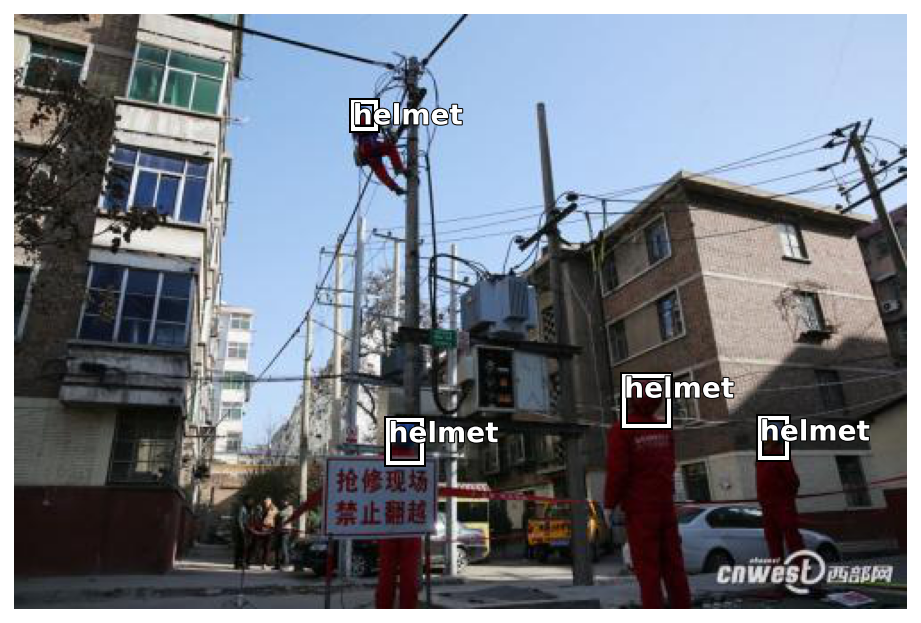

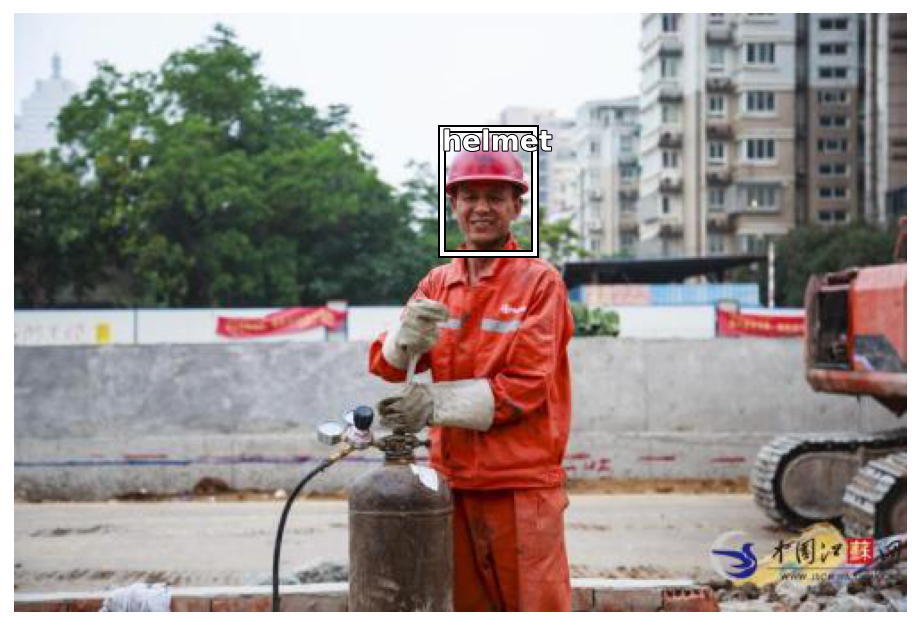

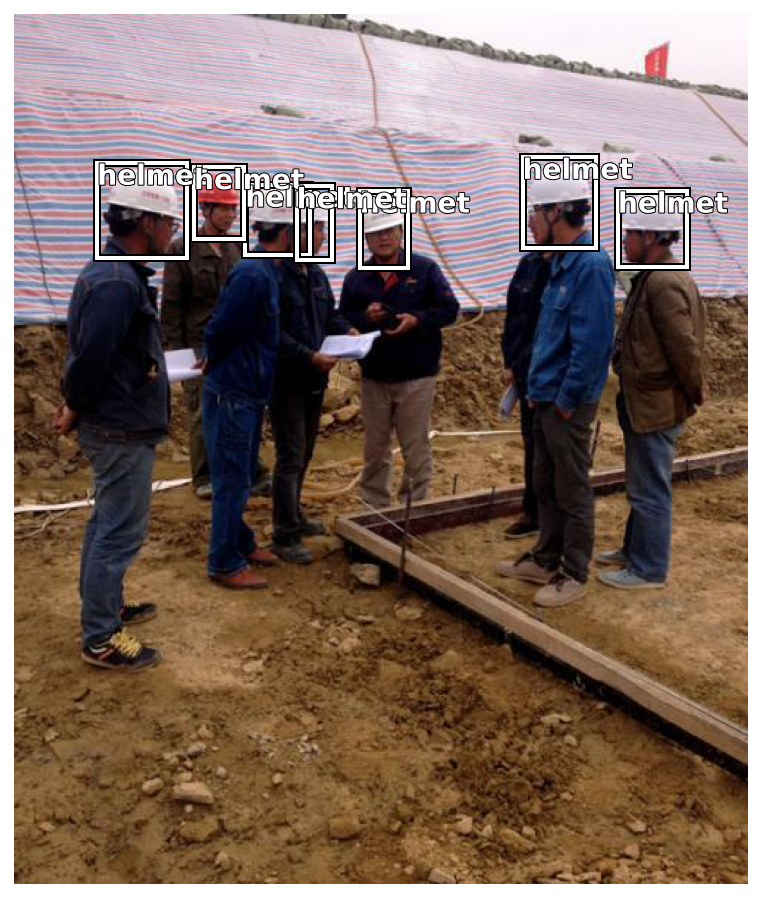

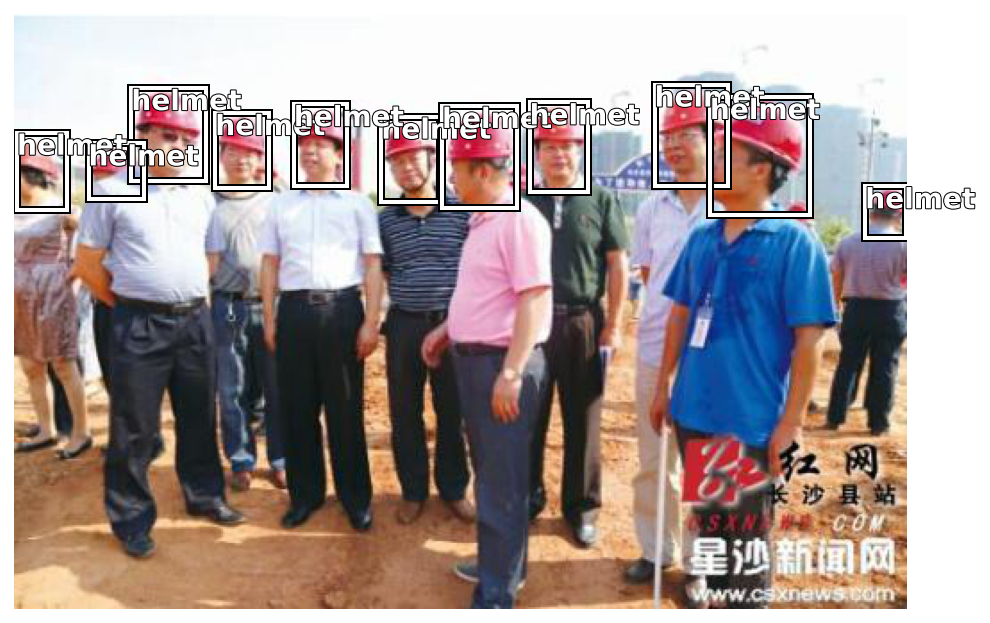

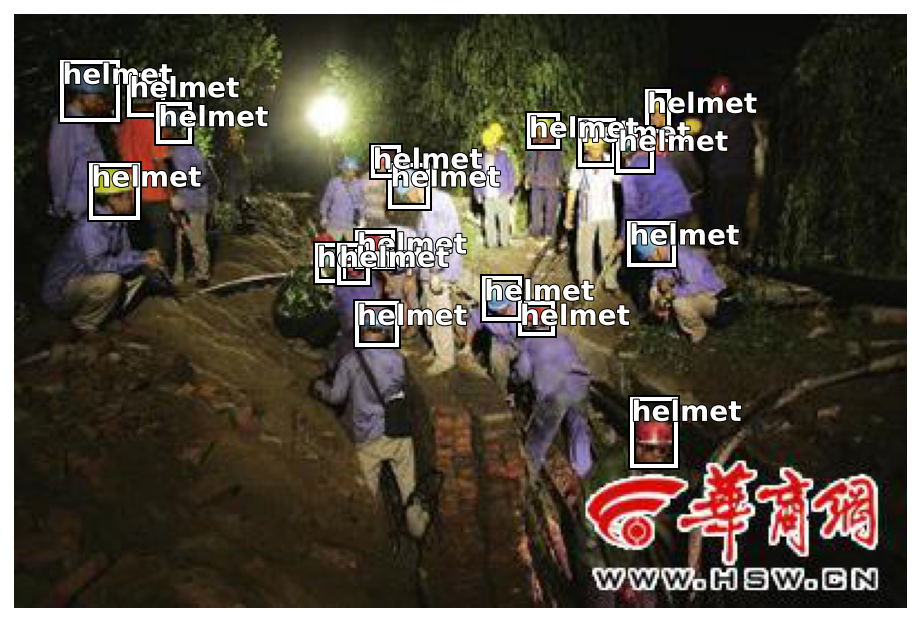

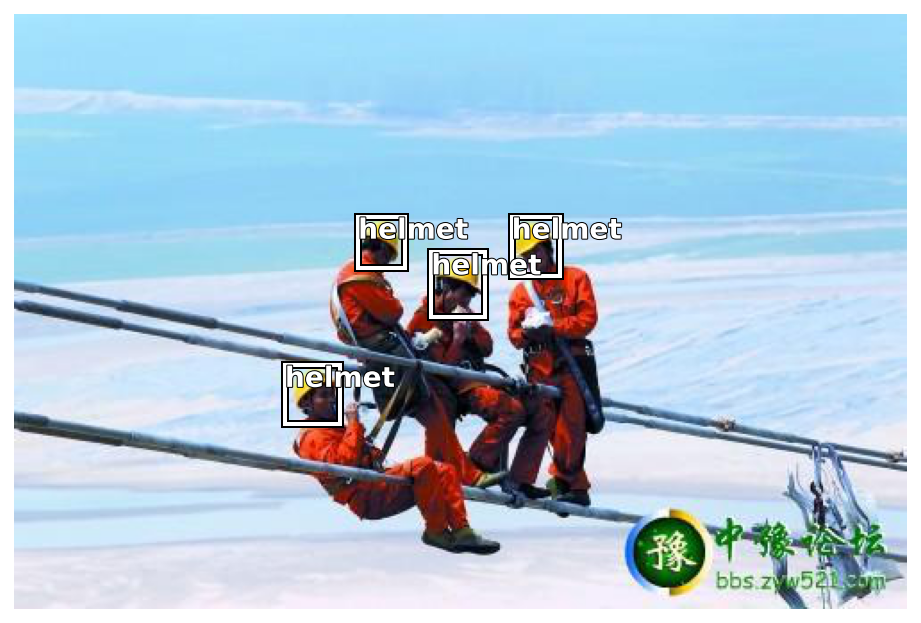

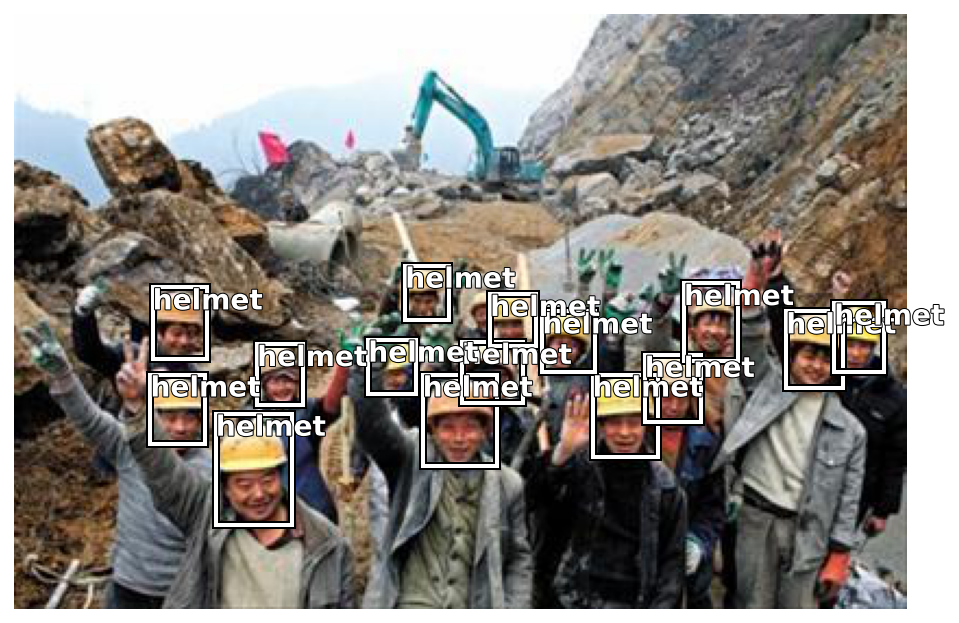

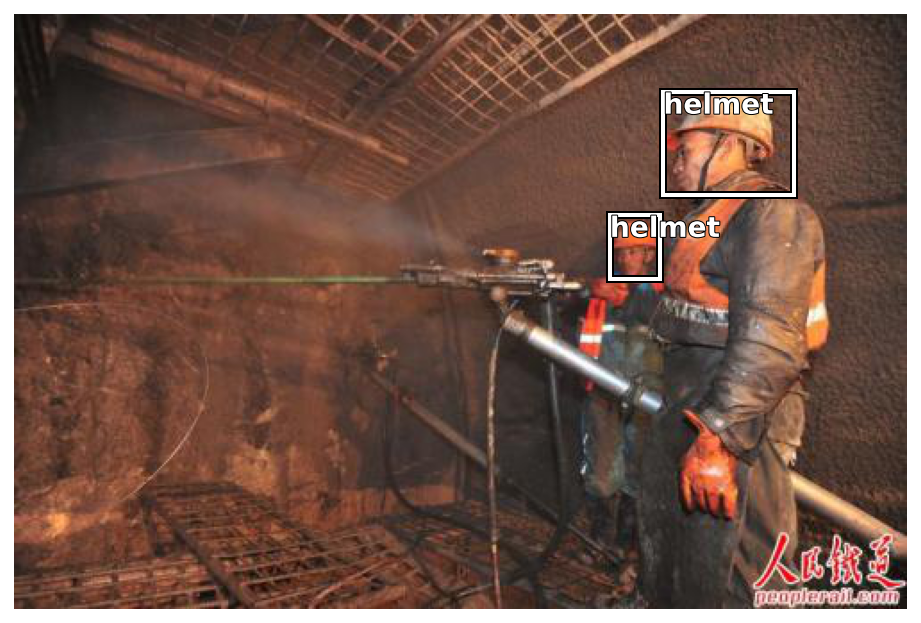

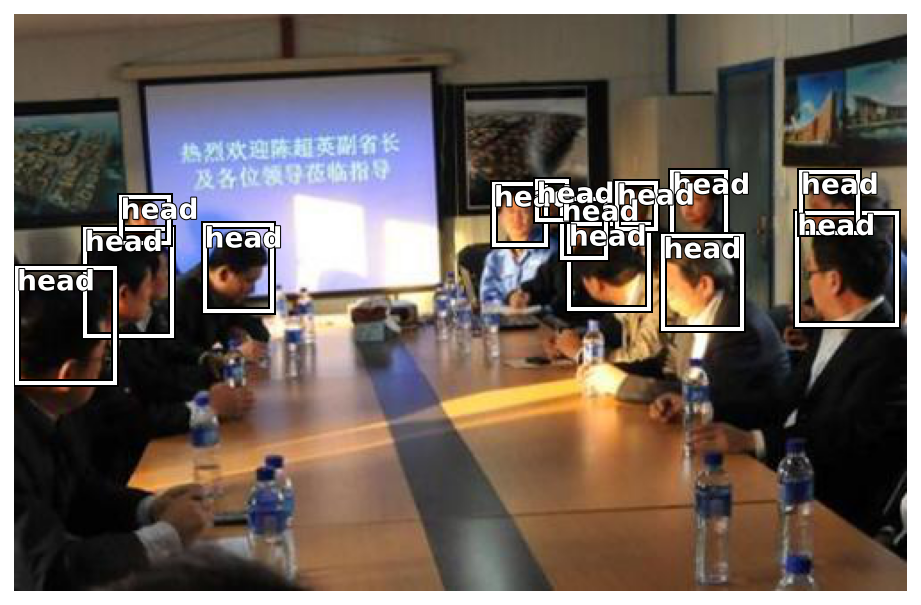

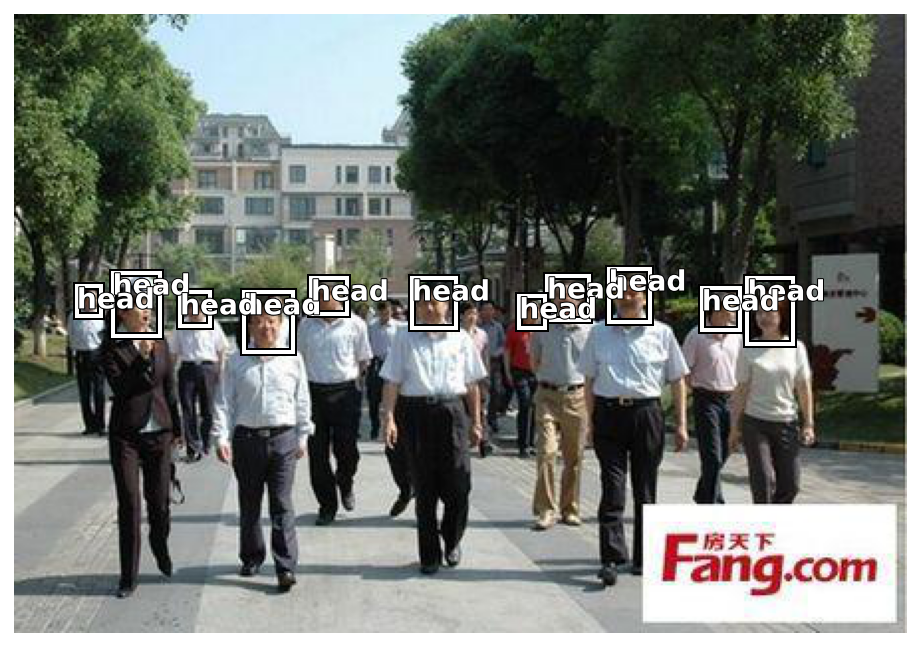

In [270]:
i = 0
while i < 10:
    show_sam(random.randint(0,5268))
    i += 1

create Data Batch

In [271]:
get_y_func = lambda o: hat2bbox[Path(o).name] 

In [272]:
tfms = 5
size = 512

In [273]:
data = (ObjectItemList.from_df(dframe ,path_all, folder = 'train' ,cols='file_name')
        #Where are the images? ->
        .split_by_rand_pct()                          
        #How to split in train/valid? -> randomly with the default 20% in valid
        .label_from_func(get_y_func)
        #How to find the labels? -> use get_y_func on the file name of the data
        .transform(size=size,tfm_y=True)
        #Data augmentation? -> Standard transforms; also transform the label images
        .databunch(bs=8, collate_fn=bb_pad_collate))  

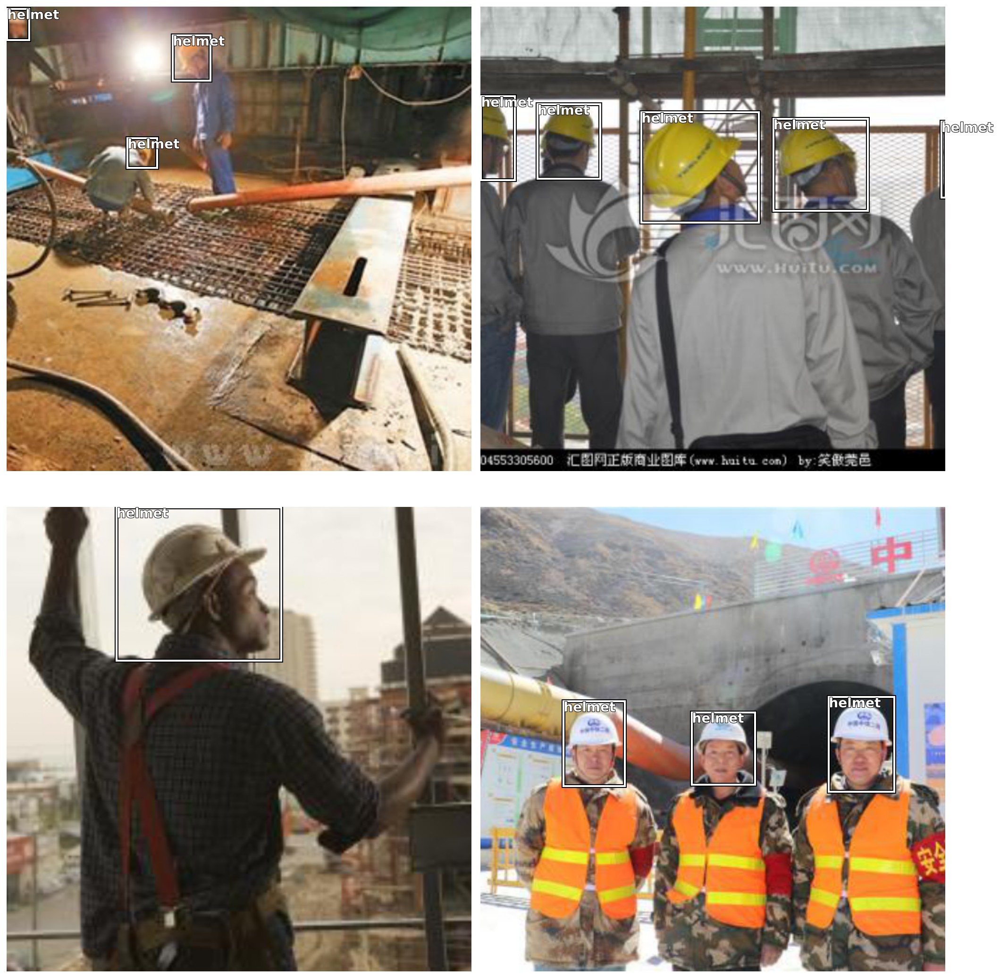

In [274]:
data.show_batch(rows=2,  figsize=(15,15))

In [275]:
len(data.train_ds),len(data.valid_ds),data.classes

(4216, 1053, ['background', 'head', 'helmet'])

In [276]:
anchors = create_anchors(sizes=[(32,32)], ratios=[1], scales=[0.3, 0.6, 1.2, 2, 2.8, 3.4,])

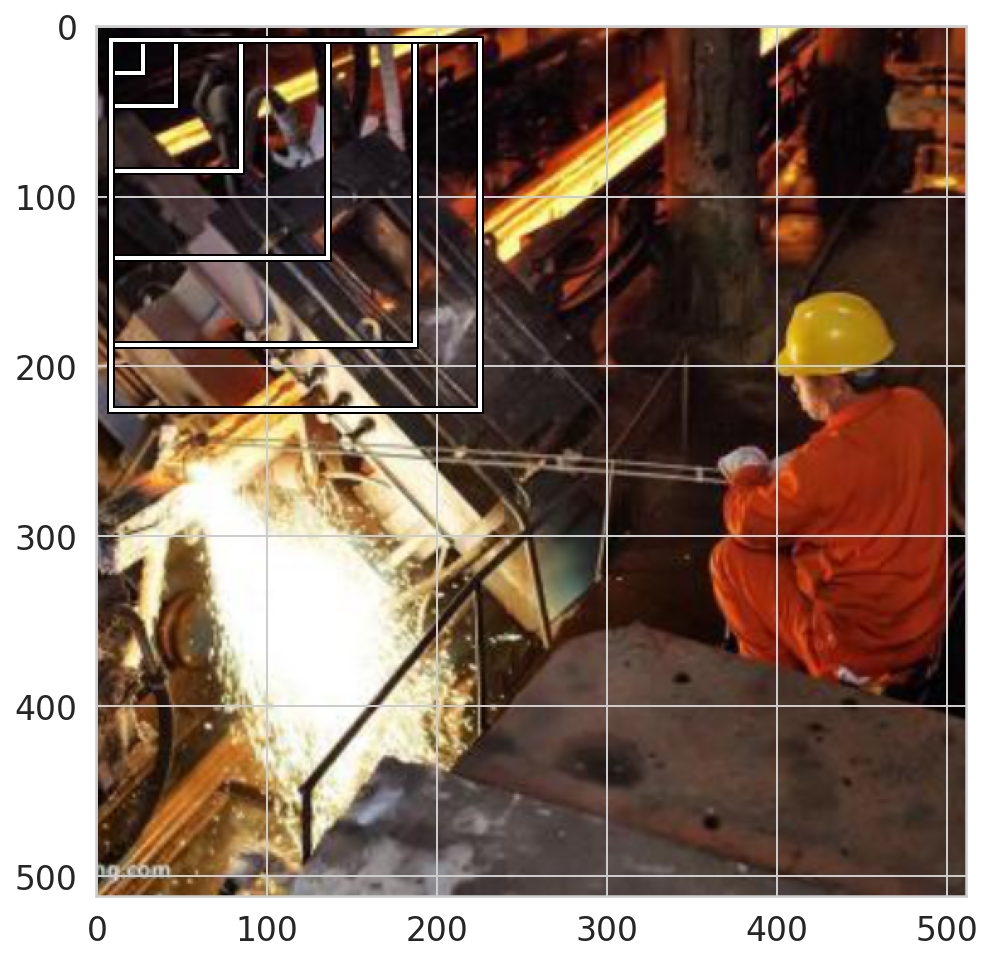

In [277]:
fig,ax = plt.subplots(figsize=(8,8))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:6]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

In [278]:
len(anchors)


6144

Now create the network. Note that for this step, internet access is required, since fast.ai wants to download the pre-trained weights for the ResNet18 stem.

In [279]:
n_classes = data.train_ds.c

crit = RetinaNetFocalLoss(anchors)

encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=6, sizes=[32], chs=32, final_bias=-4., n_conv=3)
voc = PascalVOCMetric(anchors, size, [i for i in data.train_ds.y.classes[1:]])
learn = Learner(data, model, 
                loss_func=crit, 
                callback_fns=[BBMetrics],
                metrics=[voc],
                model_dir='/content/gdrive/My Drive/Hard hat detection challenge')

In [280]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

In [281]:
gc.collect()

41960

epoch,train_loss,valid_loss,pascal_voc_metric,BBloss,focal_loss,AP-head,AP-helmet,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


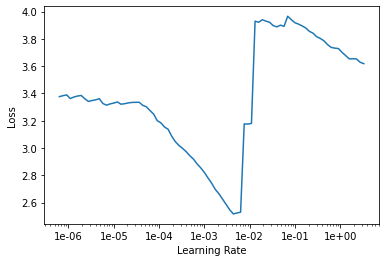

In [40]:
learn.lr_find()
learn.recorder.plot()


the loss was very good starting from 1e-03

In [41]:
learn.fit_one_cycle(3, 1e-3 , callbacks = [ SaveModelCallback(learn, every ='improvement', monitor = 'AP-helmet', name = 'best_model' ) ] )

epoch,train_loss,valid_loss,pascal_voc_metric,BBloss,focal_loss,AP-head,AP-helmet,time
0,0.688791,0.519074,0.556122,0.188561,0.330513,0.462936,0.649309,03:45
1,0.424760,0.403976,0.609000,0.141768,0.262208,0.536744,0.681257,03:44
2,0.234888,0.271581,0.657791,0.114555,0.157027,0.606082,0.709501,03:44


Better model found at epoch 0 with AP-helmet value: 0.6493092684250534.
Better model found at epoch 1 with AP-helmet value: 0.6812567685847044.
Better model found at epoch 2 with AP-helmet value: 0.7095012449455357.


In [42]:
learn.load('best_model');
learn.export('/content/gdrive/My Drive/Hard hat detection challenge/safetyHelmet.pkl');

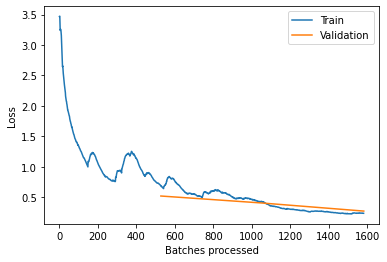

In [43]:
learn.recorder.plot_losses()


In [44]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3, callbacks = [SaveModelCallback(learn, every ='improvement', monitor ='AP-helmet', name ='best_model_ft')] )

epoch,train_loss,valid_loss,pascal_voc_metric,BBloss,focal_loss,AP-head,AP-helmet,time
0,0.266277,0.314416,0.636224,0.124117,0.190298,0.556543,0.715906,04:05
1,0.441874,0.491679,0.582293,0.162402,0.329277,0.498866,0.665720,04:07
2,0.777927,0.726643,0.450550,0.211387,0.515256,0.370410,0.530690,04:07
3,0.555408,0.567903,0.585445,0.180882,0.387021,0.555527,0.615363,04:07
4,0.581015,0.517561,0.531038,0.170484,0.347077,0.428064,0.634012,04:08
5,0.308943,0.335443,0.629121,0.121818,0.213626,0.559178,0.699064,04:08
6,0.254334,0.329767,0.645249,0.116701,0.213065,0.582125,0.708373,04:09
7,0.142841,0.292953,0.672526,0.104187,0.188765,0.630280,0.714771,04:08
8,0.102184,0.312048,0.686018,0.102174,0.209874,0.643852,0.728184,04:08
9,0.081419,0.331227,0.682611,0.102419,0.228808,0.641112,0.724109,04:07


Better model found at epoch 0 with AP-helmet value: 0.7159060029669476.
Better model found at epoch 8 with AP-helmet value: 0.7281839526033308.


In [284]:
learn.load('best_model_ft');
learn.export('/content/gdrive/My Drive/Hard hat detection challenge/safetyHelmet_ft.pkl');

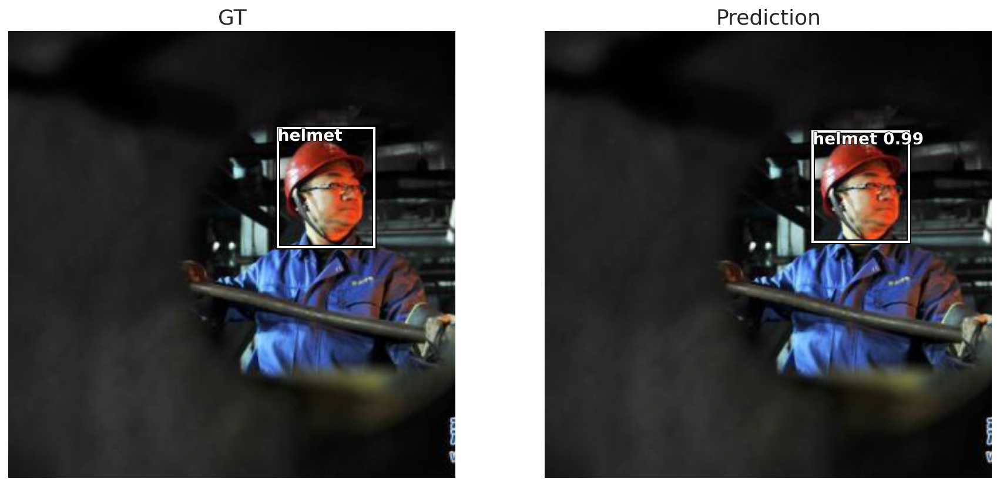

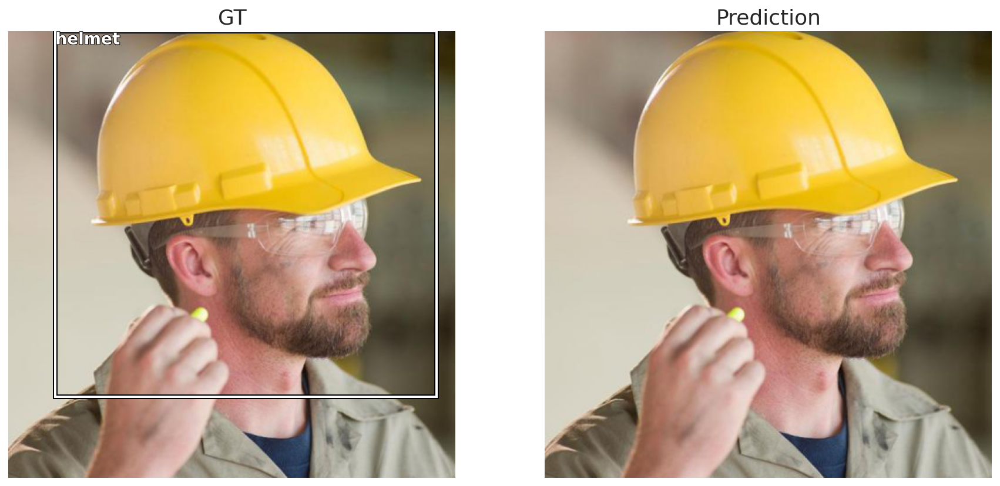

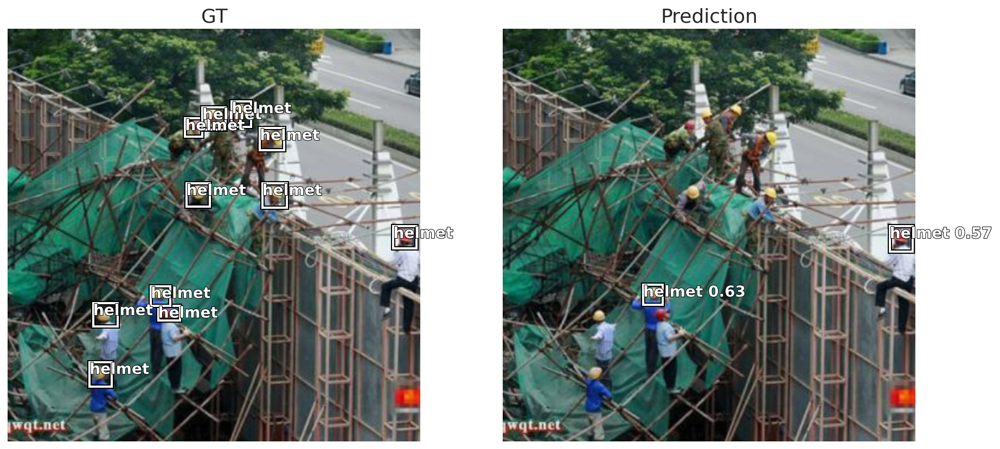

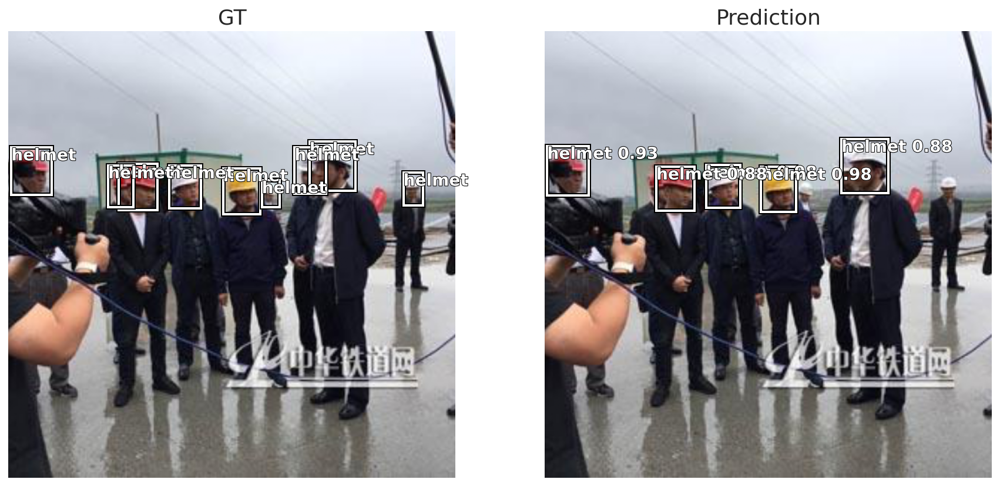

In [211]:
show_results_side_by_side(learn, anchors, detect_thresh=0.5, nms_thresh=0.1, image_count=4)

In [282]:
import scipy.sparse as sparse


In [300]:
def predict(learn: Learner, anchors, detect_thresh:float=0.2, nms_thresh: float=0.3,  image_count: int=2000):

    with torch.no_grad():
        img_batch, target_batch = learn.data.one_batch(DatasetType.Valid, False, False, False)

        prediction_batch = learn.model(img_batch[:image_count])
        class_pred_batch, bbox_pred_batch = prediction_batch[:2]

        bbox_gt_batch, class_gt_batch = target_batch[0][:image_count], target_batch[1][:image_count]

        for img, bbox_gt, class_gt, clas_pred, bbox_pred in list(
                zip(img_batch, bbox_gt_batch, class_gt_batch, class_pred_batch, bbox_pred_batch)):
            if hasattr(learn.data, 'stats'):
                img = Image(learn.data.denorm(img))
            else:
                img = Image(img)

            bbox_pred, scores, preds = process_output(clas_pred, bbox_pred, anchors, detect_thresh)
            if bbox_pred is not None:
                to_keep = nms(bbox_pred, scores, nms_thresh)
                bbox_pred, preds, scores = bbox_pred[to_keep].cpu(), preds[to_keep].cpu(), scores[to_keep].cpu()

            t_sz = torch.Tensor([*img.size])[None].cpu()
            bbox_gt = bbox_gt[np.nonzero(class_gt)].squeeze(dim=1).cpu()
            class_gt = class_gt[class_gt > 0] - 1
            # change gt from x,y,x2,y2 -> x,y,w,h
            bbox_gt[:, 2:] = bbox_gt[:, 2:] - bbox_gt[:, :2]

            bbox_gt = to_np(rescale_boxes(bbox_gt, t_sz))
            if bbox_pred is not None:
                bbox_pred = to_np(rescale_boxes(bbox_pred, t_sz))
                # change from center to top left
                bbox_pred[:, :2] = bbox_pred[:, :2] - bbox_pred[:, 2:] / 2


            #show_results(img, bbox_pred, preds, scores, learn.data.train_ds.classes[1:] , bbox_gt, class_gt, (15, 15), titleA="GT", titleB="Prediction")
            
            #d = {'bbox_pred':sparse.coo_matrixb(box_pred), 'scores':sparse.coo_matrix(scores),'class':sparse.coo_matrix(learn.data.train_ds.classes[1:])}
            #output_df = pd.DataFrame(data=d)
            #output_df = pd.DataFrame(data)
            #arr = sparse.coo_matrix(bbox_pred)
            #df['bbox_pred'] = arr.toarray().tolist()
            #print(bbox_pred.type())
            #output_df  = pd.DataFrame(np.array([bbox_pred, scores, learn.data.train_ds.classes[1:]]),
                   #columns=['a', 'b', 'c'])
            
            #output_df 
            #print(bbox_pred.shape[0])
            #print(len(scores))
            #print(len(learn.data.train_ds.classes[1:]))
            #bbox_pred = np.array(bbox_pred)
            scores = np.array(scores)
            #classs = np.array(learn.data.train_ds.classes[1:])
            #d = {'classs':[classs],'bbox_pred':[bbox_pred],'confidence':[scores]}
            #output_df = pd.DataFrame(data=d)
            #print(output_df)
            #print(bbox_pred)
            #print(output_df.shape)
            #print(preds)  #how many predictions per image
            print(scores)

            

In [302]:
predict(learn, anchors, detect_thresh=0.5, nms_thresh=0.1, image_count=5)

[0.992082 0.797685 0.618828 0.554063]
None
[0.992294 0.982142 0.973084 0.965613 0.822316 0.789802]
[0.835421 0.53147 ]
[0.922118 0.831118 0.54933 ]
[0.896006]
[0.990251 0.877583]
[0.905207]


In [84]:
data.train_ds

LabelList (1053 items)
x: ObjectItemList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: ObjectCategoryList
ImageBBox (512, 512),ImageBBox (512, 512),ImageBBox (512, 512),ImageBBox (512, 512),ImageBBox (512, 512)
Path: /content/gdrive/My Drive/Hard hat detection challenge

In [ ]:
print(data.valid_ds.x.items[:])

['/content/gdrive/My Drive/Hard hat detection challenge/train/005233_jpg.rf.4d90df6231ffaa2af4e3ee51f0e1b6b1.jpg'
 '/content/gdrive/My Drive/Hard hat detection challenge/train/001686_jpg.rf.0fa3f850879f68067a066ce868d82c1f.jpg'
 '/content/gdrive/My Drive/Hard hat detection challenge/train/001988_jpg.rf.274ce814639becb31e89c7a005c7c9f4.jpg'
 '/content/gdrive/My Drive/Hard hat detection challenge/train/004483_jpg.rf.2124fac007f1bbe9296c57595bbb5553.jpg' ...
 '/content/gdrive/My Drive/Hard hat detection challenge/train/000926_jpg.rf.36abbee996ba5bc533cdc3718166ef7c.jpg'
 '/content/gdrive/My Drive/Hard hat detection challenge/train/000667_jpg.rf.35f73be306cd6103ce1534f3fa02fb2b.jpg'
 '/content/gdrive/My Drive/Hard hat detection challenge/train/004370_jpg.rf.875febe15aa5e0b2324e8f188cda0590.jpg'
 '/content/gdrive/My Drive/Hard hat detection challenge/train/000224_jpg.rf.fc8e73c6a4b0e5ab2c2eff98c9aea682.jpg']


In [147]:
!git clone https://github.com/fizyr/keras-retinanet.git


Cloning into 'keras-retinanet'...
remote: Enumerating objects: 6014, done.
remote: Total 6014 (delta 0), reused 0 (delta 0), pack-reused 6014
Receiving objects: 100% (6014/6014), 13.44 MiB | 6.93 MiB/s, done.
Resolving deltas: 100% (4061/4061), done.


In [148]:
!pip install --upgrade keras


Requirement already up-to-date: keras in /usr/local/lib/python3.6/dist-packages (2.4.3)


In [149]:
%cd keras-retinanet/

!pip install .

/content/keras-retinanet
Processing /content/keras-retinanet
  Created wheel for keras-retinanet: filename=keras_retinanet-0.5.1-cp36-cp36m-linux_x86_64.whl size=171487 sha256=48dbbd8d5b133e7e2b1c022e63061a29a6448b14ced00c24ee7966966f874321
  Stored in directory: /root/.cache/pip/wheels/b2/9f/57/cb0305f6f5a41fc3c11ad67b8cedfbe9127775b563337827ba
  Created wheel for keras-resnet: filename=keras_resnet-0.2.0-py2.py3-none-any.whl size=20487 sha256=200cb19d8bc8ccc2c794070f25c6246f683a8c2f5ea30628c7d6dc49c9685474
  Stored in directory: /root/.cache/pip/wheels/5f/09/a5/497a30fd9ad9964e98a1254d1e164bcd1b8a5eda36197ecb3c
Successfully built keras-retinanet keras-resnet


In [150]:
!python setup.py build_ext --inplace


running build_ext
cythoning keras_retinanet/utils/compute_overlap.pyx to keras_retinanet/utils/compute_overlap.c
/usr/local/lib/python3.6/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/keras-retinanet/keras_retinanet/utils/compute_overlap.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'keras_retinanet.utils.compute_overlap' extension
creating build
creating build/temp.linux-x86_64-3.6
creating build/temp.linux-x86_64-3.6/keras_retinanet
creating build/temp.linux-x86_64-3.6/keras_retinanet/utils
x86_64-linux-gnu-gcc -pthread -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/include/python3.6m -I/usr/local/lib/python3.6/dist-packages/numpy/core/include -c keras_retinanet/utils/compute_overlap.c -o build/temp.linux-x86_64-3.6/keras_retinanet/utils/compute_over

In [151]:
!pip install gdown
!pip install tensorflow-gpu

     |████████████████████████████████| 320.4MB 51kB/s 


In [152]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters
from sklearn.model_selection import train_test_split
import urllib
import os
import csv
import cv2
import time
from PIL import Image

from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

In [162]:
os.makedirs("snapshots", exist_ok=True)


In [163]:
!gdown --id 1wPgOBoSks6bTIs9RzNvZf6HWROkciS8R --output snapshots/resnet50_csv_10.h5

Downloading...
From: https://drive.google.com/uc?id=1wPgOBoSks6bTIs9RzNvZf6HWROkciS8R
To: /content/keras-retinanet/snapshots/resnet50_csv_10.h5
249MB [00:05, 46.6MB/s]


In [182]:

train_df, test_df = train_test_split(
  df, 
  test_size=0.2, 
  random_state=RANDOM_SEED
)

In [183]:
ANNOTATIONS_FILE = 'annotations.csv'
CLASSES_FILE = 'classes.csv'

In [184]:
train_df.to_csv(ANNOTATIONS_FILE, index=False, header=None)

In [190]:
classes = set(['head','helmet','person'])

with open(CLASSES_FILE, 'w') as f:
  for i, line in enumerate(sorted(classes)):
    f.write('{},{}\n'.format(line,i))

In [193]:
PRETRAINED_MODEL = './snapshots/_pretrained_model.h5'

URL_MODEL = 'https://github.com/fizyr/keras-retinanet/releases/download/0.5.1/resnet50_coco_best_v2.1.0.h5'
urllib.request.urlretrieve(URL_MODEL, PRETRAINED_MODEL)

print('Downloaded pretrained model to ' + PRETRAINED_MODEL)

Downloaded pretrained model to ./snapshots/_pretrained_model.h5


In [161]:
!ls snapshots

_pretrained_model.h5


In [195]:

model_path = os.path.join('snapshots', sorted(os.listdir('snapshots'), reverse=True)[0])
print(model_path)

model = models.load_model(model_path, backbone_name='resnet50')
model = models.convert_model(model)

labels_to_names = pd.read_csv(CLASSES_FILE, header=None).T.loc[0].to_dict()

snapshots/resnet50_csv_10.h5


In [196]:
def predict(image):
  image = preprocess_image(image.copy())
  image, scale = resize_image(image)

  boxes, scores, labels = model.predict_on_batch(
    np.expand_dims(image, axis=0)
  )

  boxes /= scale

  return boxes, scores, labels

In [197]:
THRES_SCORE = 0.6

def draw_detections(image, boxes, scores, labels):
  for box, score, label in zip(boxes[0], scores[0], labels[0]):
    if score < THRES_SCORE:
        break

    color = label_color(label)

    b = box.astype(int)
    draw_box(image, b, color=color)

    caption = "{} {:.3f}".format(labels_to_names[label], score)
    draw_caption(image, b, caption)

In [198]:
def show_detected_objects(image_row):
  img_path = image_row.image_name
  
  image = read_image_bgr(img_path)

  boxes, scores, labels = predict(image)

  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

  true_box = [
    image_row.x_min, image_row.y_min, image_row.x_max, image_row.y_max
  ]
  draw_box(draw, true_box, color=(255, 255, 0))

  draw_detections(draw, boxes, scores, labels)

  plt.axis('off')
  plt.imshow(draw)
  plt.show()
  

In [199]:
test_df.head(n=10)


,filename,xmin,ymin,xmax,ymax,class
19805,000886_jpg.rf.fa276ff4287881a32e645d9d3a235817...,239,66,298,143,head
12704,004819_jpg.rf.a17c8144556b6652931ed63d1b944134...,376,71,399,93,helmet
14649,003440_jpg.rf.b86e5afd7f8b9902aca3798086af746d...,355,27,421,104,helmet
8918,004682_jpg.rf.737193e2b058c025e0bab9bf125cc561...,203,76,226,107,head
14592,003356_jpg.rf.b81556b2ff6a12815760d9ee28866ed6...,241,134,256,152,head
14464,000366_jpg.rf.b592a075ba6dbf9adb10269fb86e9d26...,270,32,311,89,head
3474,002078_jpg.rf.2d052e0daaf778aa5ae4beeb96ab85bf...,184,210,203,234,helmet
18014,004323_jpg.rf.e3fbf9b4a4ac69ff990c60db5ce88625...,267,175,285,202,head
9012,000367_jpg.rf.759bc65af1d3172de731247a5095a3fd...,99,41,228,203,helmet
18064,004991_jpg.rf.e42b3934bd3dd7257ca3a4bd643c131a...,305,85,347,142,helmet


In [309]:
confidence = predict(learn, anchors, detect_thresh=0.5, nms_thresh=0.1, image_count=6)

[0.992082 0.797685 0.618827 0.554063]
None
[0.992294 0.982142 0.973084 0.965614 0.822316 0.789802]
[0.835421 0.531469]
[0.922117 0.831118 0.54933 ]
[0.896006]


In [311]:
test_df['confidence'] = 0.99202

In [315]:
test_df= test_df [['filename','class','confidence','xmin','ymin','xmax','ymax']]


In [316]:
test_df.head(n=3)

,filename,class,confidence,xmin,ymin,xmax,ymax
19805,000886_jpg.rf.fa276ff4287881a32e645d9d3a235817...,head,0.99202,239,66,298,143
12704,004819_jpg.rf.a17c8144556b6652931ed63d1b944134...,helmet,0.99202,376,71,399,93
14649,003440_jpg.rf.b86e5afd7f8b9902aca3798086af746d...,helmet,0.99202,355,27,421,104


In [322]:
from google.colab import files

test_df.to_csv('hard_hat_df.csv', index=False)
files.download('hard_hat_df.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

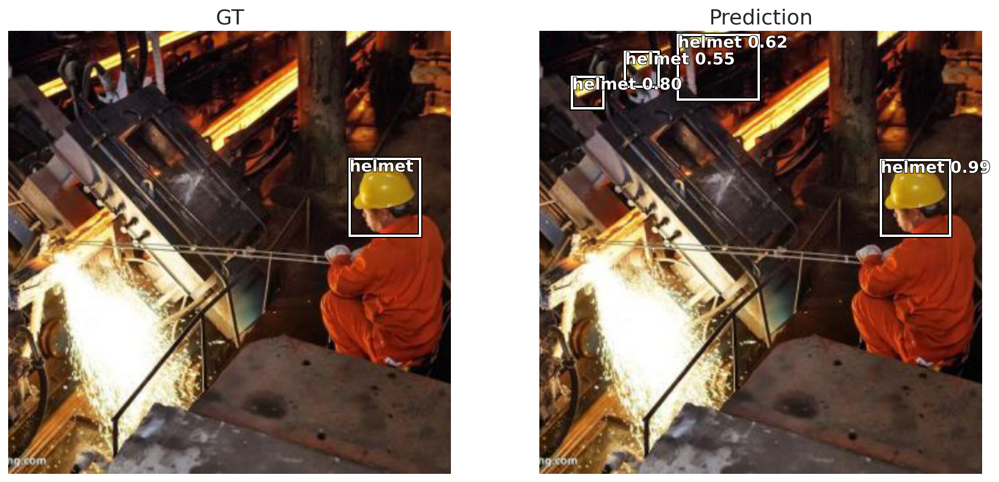

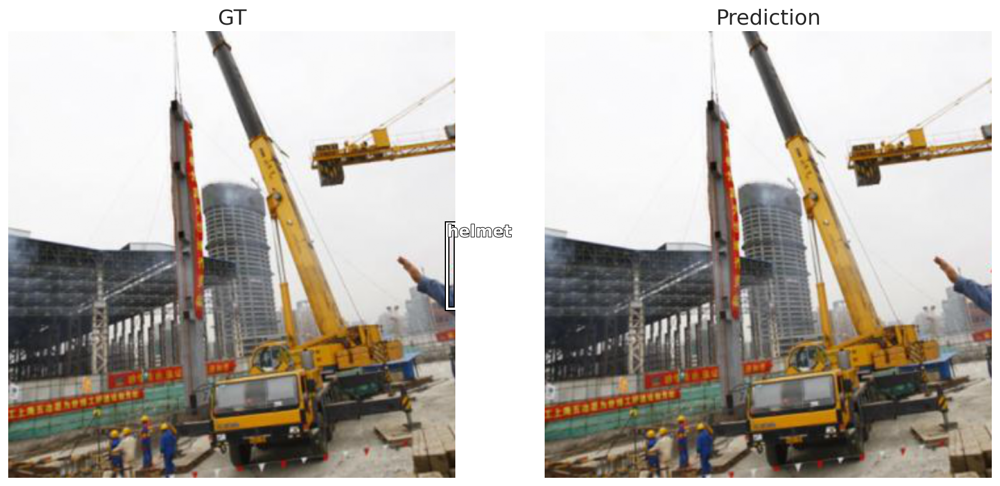

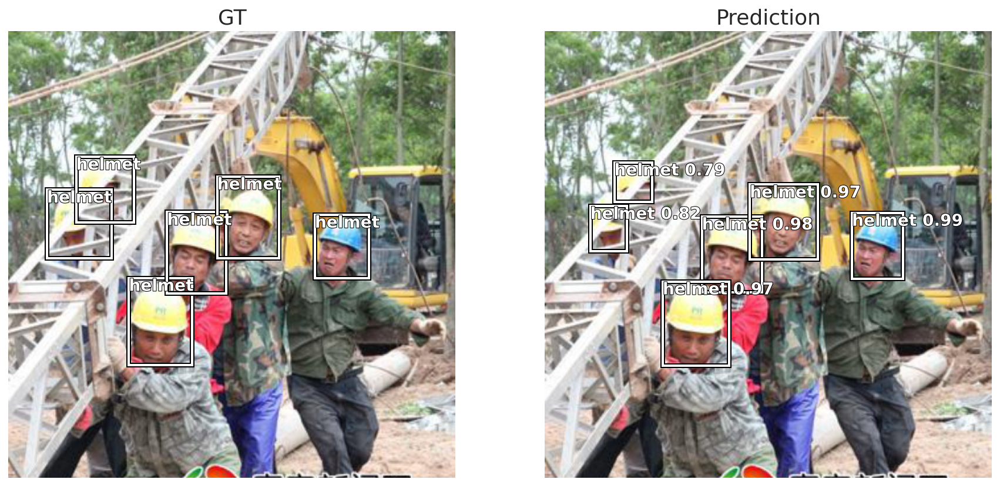

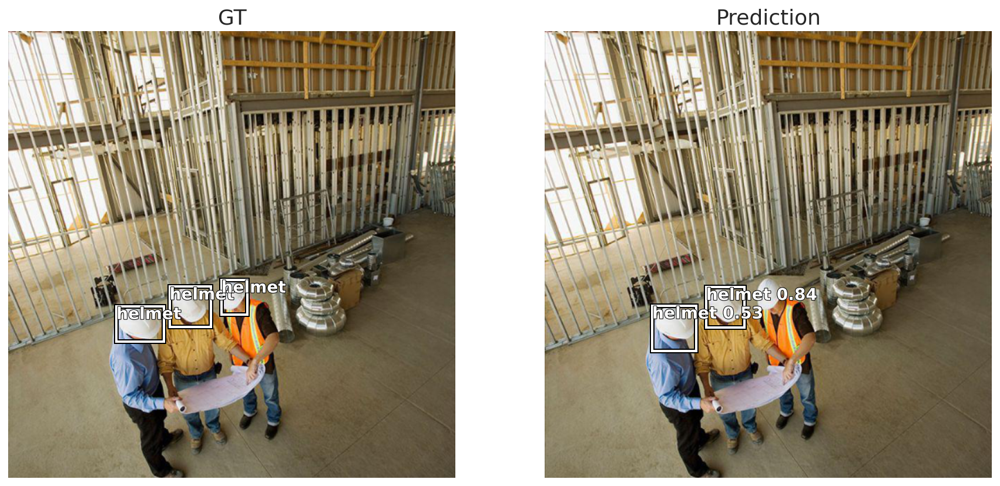

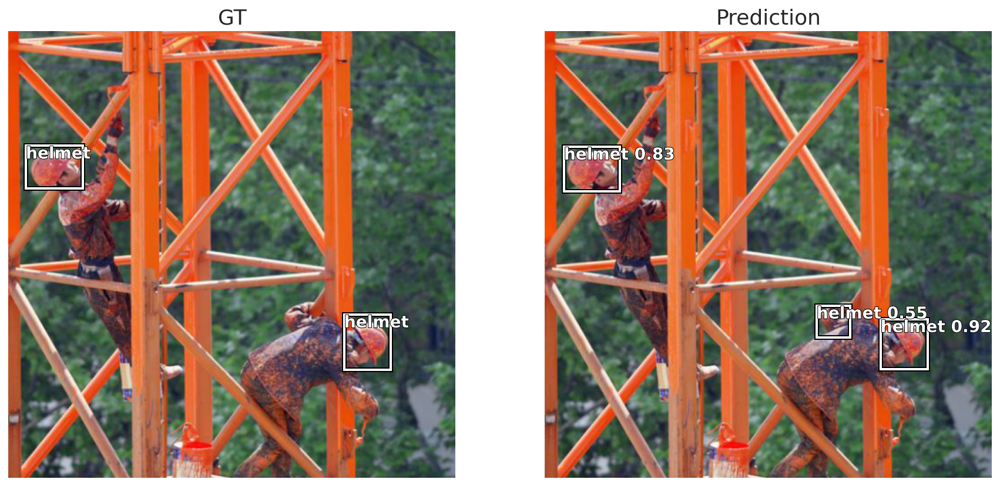

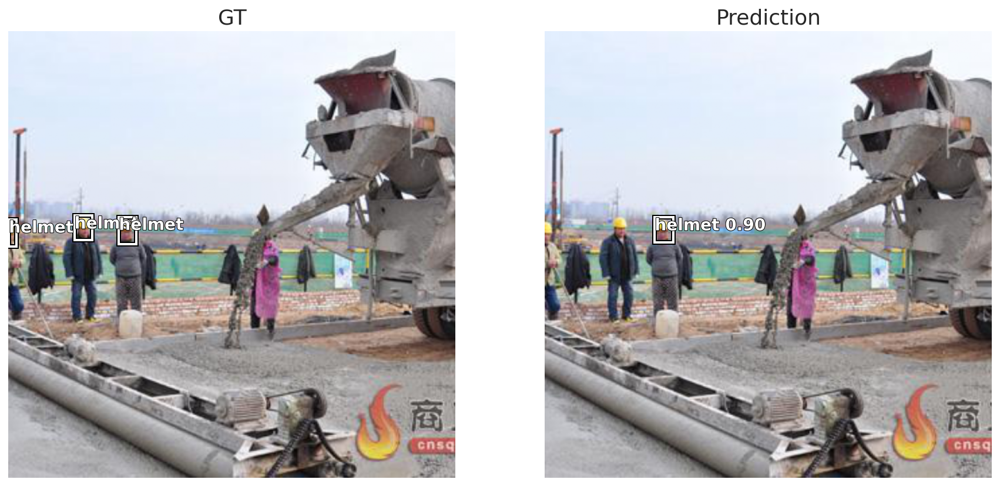

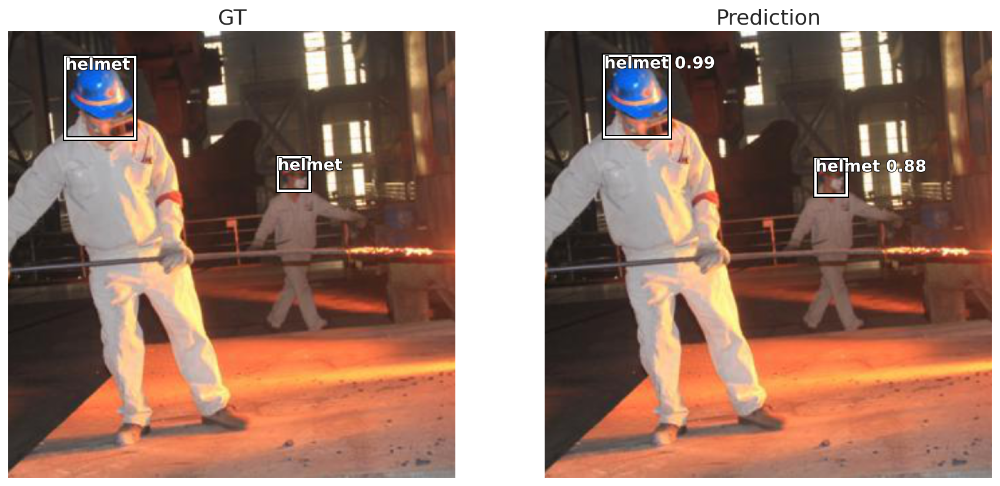

In [313]:
show_results_side_by_side(learn, anchors, detect_thresh=0.5, nms_thresh=0.1, image_count=7)